I want to see what some of the filters in the learned models look like. 

In [31]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

import tensorflow as tf

In [32]:
from uatu.watchers import *

In [33]:
def get_filter(model_init_fn, fname, filter_name,  adv = False):
    tf.reset_default_graph()

    x = tf.placeholder(tf.float32, [None, 256,256,1], name = 'x')

    #training = tf.placeholder(tf.bool, name='training')
    if adv:
        with tf.variable_scope("kappa_filters") as scope:
            preds = model_init_fn(x, training=False)

    else:
        preds = model_init_fn(x, training=False)            
            
    with tf.device('/cpu:0'):
        saver = tf.train.Saver()

    with tf.Session() as sess:
        #with tf.device('/cpu:0'):
        saver.restore(sess, fname)
        
        with tf.variable_scope("kappa_filters/"+filter_name, reuse=True) as scope_conv:
            W_conv = tf.get_variable('weights')
            return W_conv.eval()

In [34]:
net = 'adv'
network_fname = '../networks/gupta_net_kappa_adv_abs-9050'
model_init_fn = gupta_adv_network_init_fn
cost_fn = adversarial_standard_abs_cost_fn
training=False
adv = True

In [42]:
weights = get_filter(model_init_fn, network_fname, 'conv1', adv = adv)

INFO:tensorflow:Restoring parameters from ../networks/gupta_net_kappa_adv_abs-9050


In [39]:
weights.shape

(3, 3, 128, 128)

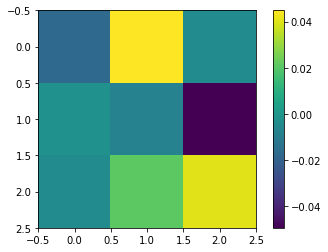

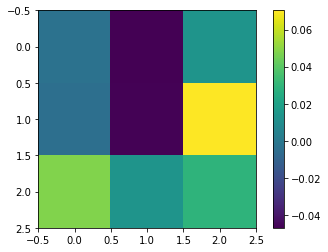

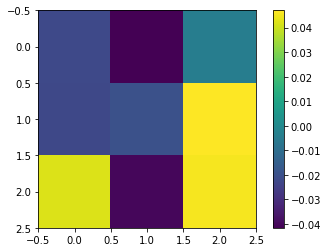

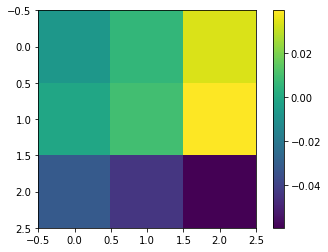

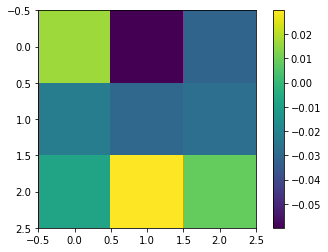

...

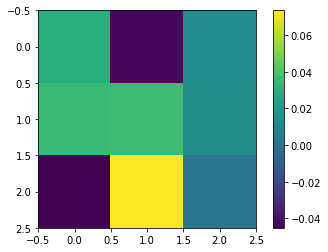

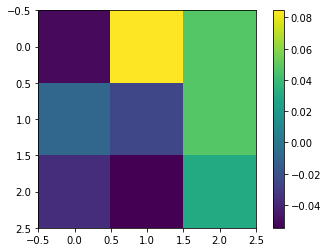

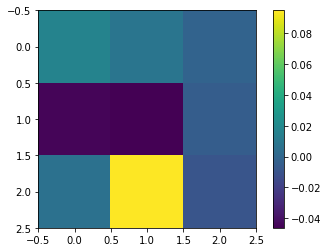

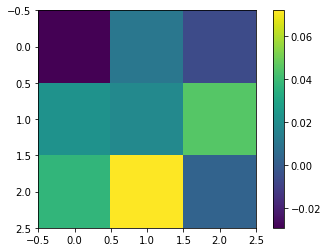

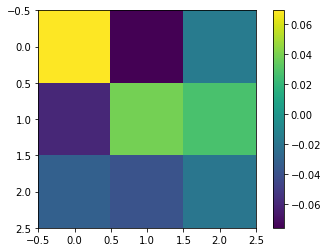

KeyboardInterrupt: 

In [41]:
for i in xrange(weights.shape[2]):
    for j in xrange(weights.shape[3]):
        im = plt.imshow(weights[:,:,i,j])
        c = plt.colorbar(im)
        plt.show()